### Final Project Answers (Table of Contents):

Your final project post should include: 

1. **A brief recap of your data, goals, and tasks, focusing on those that most directly influence your design:** 
    - See Part 1 below.

2. **Screenshots of and/or a link to your visualization implementation:** 
    - See Task 1 : Task 3 below.

3. **A summary of the key elements of your design and accompanying justification:**
    - See summary and design justifications below each visualization under Task 1 : Task 3.

4. **A discussion of your final evaluation approach, including the procedure, people recruited, and results:** 
    - See Part 3 below.

5. **A synthesis of your findings, including what elements of your approach worked well and what elements you would refine in future iterations.** 
    - See Part 4 below.

### Visualization Project Part 1: Finding your Data
---
Locate a dataset that you are interested in working with. The data should be sufficiently complex that you can ask lots of questions about it and engage in creative design techniques, but not so complex that you need specialized hardware or algorithmic approaches to analyze. While you are welcome to use any data you’d like, I recommend that your datasets are tabular (e.g., CSV, TSV, SQL, etc.), contain 5,000 or fewer datapoints (on the order of one hundred or so tends to be sufficiently interesting without causing lag in Altair), and is data that you’re comfortable discussing as part of the course (e.g., avoid data that is overly private or classified). 

Discuss your dataset, including the data’s source, key attributes/dimensions of the data, and your goals for working with that data (i.e., what are the key questions you want to answer). Identify existing relevant visualizations for working with that data (either using the same data, showing the same concepts, or just that might provide some inspiration) and critique those visualizations based on the practices from this module. What works well? What might need improvement or to change to answer your target questions? 

### Part 1 Answers:

##### Dataset details:
The dataset used is from the Union of Concerned Scientists (UCSUSA) which details all openly-known satellites orbitting the earth at the time of previous update - January 1, 2023.

- **Source:** *Accessed 12/1/2023* | UCS-Satellite-Database-Officialname-1-1-2023.csv | https://www.ucsusa.org/resources/satellite-database
- 6718 satellites listed.
- 68 Features (columns) for each satellite including `name`, `country of owner`, `purpose`, `orbital information`, `launch information`, etc..
    - Feature Appendix https://s3.amazonaws.com/ucs-documents/nuclear-weapons/sat-database/4-11-17-update/User+Guide+1-1-17+wAppendix.pdf

*Exported this notebook to html using 'jupyter nbconvert Active-Satellites-Notebook.ipynb --no-input --to html'*

##### Preliminary Goals for this Data:

- Determine which country has the most satellites in orbit currently and execute a method that allows users to reach increased depths of information through this visualization, likely through grouping/aggregating features.
- Create a compelling way to identify orbital information about satellites. Look into different orbit features which may impact lifespan and/or see which orbiting altitudes are most congested.
- Feature engineer interesting statistics about the age of the satellites using life expectancy and launch date information.

---

##### Existing Visualizations:
UCSUSA has a visualization highlighting each country on an image of a map that has satellites or not. They also distinguish between countries that launch satellites or not as well as have a slider depicting the same information from either 1966 or 2020. You can see it at the website above.

**Pros:**

- This visualization works well for conveying which countries poses satellites at a glance, making it especially easy to find the answer for specific countries.
- The color orange in juxtaposition to the grey map makes the information easily identifiable.
    - Also, the textured orange is holds all the positives previously mentioned while still being easily distinguishable from the normal orange.

**Cons:**

- Country names are pretty small which may not be ideal for users unfamiliar with geography.
- The slider used to switch between 1966 and 2020, while intuitive, seems frivolous. Especially since no mention of a purpose is mentioned.
- Lacking substantive information. Displaying a tooltip while hovering over each country giving more data would be a nice addition instead or in conjunction.

Overall, I believe it to be a successful visualization but has limited uses as it doesn't answer more interesting questions that live within this dataset. Giving the user the ability to reach more information depth through other methods of interaction would help improve this execution.

### EDA and Data Cleaning

In [1]:
# Import necessary packages and data.
import pandas as pd
import altair as alt
alt.data_transformers.enable('vegafusion')
from vega_datasets import data
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
from mpl_toolkits.mplot3d import Axes3D

sat_df = pd.read_csv('UCS-Satellite-Database-1-1-2023.csv')
country_codes_df = pd.read_csv('iso_3166_country_codes.csv')

In [2]:
# Clean up the data for use.
country_codes_df = country_codes_df.rename({'name' : 'Country of Operator/Owner'}, axis = 1)
country_codes_df = country_codes_df.rename({'country-code' : 'Country_Code'}, axis = 1)

# Start with the country codes dataframe to match what is used in the satellite data.
# This will help during the merge to add a country code column for use in maps.
# Should've just changed the .csv at this point but here we are.
country_codes_df.loc[country_codes_df['Country of Operator/Owner'] == 'United States of America', 'Country of Operator/Owner'] = 'USA'
country_codes_df.loc[country_codes_df['Country of Operator/Owner'] == 'United Kingdom of Great Britain and Northern Ireland', 'Country of Operator/Owner'] = 'United Kingdom'
country_codes_df.loc[country_codes_df['Country of Operator/Owner'] == 'Russian Federation', 'Country of Operator/Owner'] = 'Russia'
country_codes_df.loc[country_codes_df['Country of Operator/Owner'] == 'Korea, Republic of', 'Country of Operator/Owner'] = 'South Korea'
country_codes_df.loc[country_codes_df['Country of Operator/Owner'] == 'Taiwan, Province of China', 'Country of Operator/Owner'] = 'Taiwan'
country_codes_df.loc[country_codes_df['Country of Operator/Owner'] == 'Iran (Islamic Republic of)', 'Country of Operator/Owner'] = 'Iran'
country_codes_df.loc[country_codes_df['Country of Operator/Owner'] == "Lao People's Democratic Republic", 'Country of Operator/Owner'] = 'Laos'
country_codes_df.loc[country_codes_df['Country of Operator/Owner'] == 'Viet Nam', 'Country of Operator/Owner'] = 'Vietnam'
country_codes_df.loc[country_codes_df['Country of Operator/Owner'] == 'Venezuela (Bolivarian Republic of)', 'Country of Operator/Owner'] = 'Venezuela'
country_codes_df.loc[country_codes_df['Country of Operator/Owner'] == 'Bolivia (Plurinational State of)', 'Country of Operator/Owner'] = 'Bolivia'


# Satellite df cleaning. Mostly misspellings or duplicate categories.
# Country fixes
sat_df.loc[sat_df['Country of Operator/Owner'] == 'ESA/', 'Country of Operator/Owner'] = 'USA' # This is the Hubble Telescope!
sat_df.loc[sat_df['Country of Operator/Owner'] == 'Czech Republic', 'Country of Operator/Owner'] = 'Czechia'
sat_df.loc[sat_df['Country of Operator/Owner'] == 'China ', 'Country of Operator/Owner'] = 'China'
sat_df.loc[sat_df['Country of Operator/Owner'] == "Sinapore", 'Country of Operator/Owner'] = 'Singapore'
# Operator name fixes.
sat_df.loc[sat_df['Operator/Owner'] == "Spacex", 'Operator/Owner'] = 'SpaceX'
sat_df.loc[sat_df['Operator/Owner'] == "US Air Force ", 'Operator/Owner'] = 'US Air Force'
# Purpose category fixes.
sat_df.loc[sat_df['Purpose'] == "Earth Observation ", 'Purpose'] = 'Earth Observation'
sat_df.loc[sat_df['Purpose'] == "Earth Observation/Navigation", 'Purpose'] = 'Earth Observation'
sat_df.loc[sat_df['Purpose'] == "Communications/Navigation", 'Purpose'] = 'Communications'
sat_df.loc[sat_df['Purpose'] == "Communications/Technology Development", 'Purpose'] = 'Communications'
sat_df.loc[sat_df['Purpose'] == "Earth Observation/Communications/Space Science", 'Purpose'] = 'Earth Observation'
sat_df.loc[sat_df['Purpose'] == "Earth Observation/Space Science", 'Purpose'] = 'Earth Observation'
sat_df.loc[sat_df['Purpose'] == "Space Observation", 'Purpose'] = 'Space Science'
# Class of Orbit fixes.
sat_df.loc[sat_df['Class of Orbit'] == "LEo", 'Class of Orbit'] = 'LEO'
# Remove commas from continuos features as they don't play well with Vega-Altair.
sat_df['Launch Mass (kg.)'] = sat_df['Launch Mass (kg.)'].str.replace(',', '').astype(float)
sat_df['Apogee (km)'] = sat_df['Apogee (km)'].str.replace(',', '').astype(float)
sat_df['Perigee (km)'] = sat_df['Perigee (km)'].str.replace(',', '').astype(float)
sat_df['Period (minutes)'] = sat_df['Period (minutes)'].str.replace(',', '').astype(float)
# Inclination fixes.
sat_df.loc[sat_df['Inclination (degrees)'] == '1,436', 'Inclination (degrees)'] = '1.436'
sat_df.loc[sat_df['Inclination (degrees)'] == "USA", 'Inclination (degrees)'] = '0'
# Users Fixes
sat_df.loc[sat_df['Users'] == 'Military/Commercial', 'Users'] = 'Military'
sat_df.loc[sat_df['Users'] == 'Government/Military', 'Users'] = 'Military'
sat_df.loc[sat_df['Users'] == 'Military/Government', 'Users'] = 'Military'
sat_df.loc[sat_df['Users'] == 'Government/Civil', 'Users'] = 'Government'
sat_df.loc[sat_df['Users'] == 'Military/Civil', 'Users'] = 'Military'
sat_df.loc[sat_df['Users'] == 'Commercial/Civil', 'Users'] = 'Commercial'
sat_df.loc[sat_df['Users'] == 'Civil/Commercial', 'Users'] = 'Civil'
sat_df.loc[sat_df['Users'] == 'Commercial/Government', 'Users'] = 'Government'
sat_df.loc[sat_df['Users'] == 'Government/Commercial/Military', 'Users'] = 'Government'
sat_df.loc[sat_df['Users'] == 'Civil/Government', 'Users'] = 'Civil'
sat_df.loc[sat_df['Users'] == 'Civil/Military', 'Users'] = 'Military'
sat_df.loc[sat_df['Users'] == 'Commercial ', 'Users'] = 'Commercial'
sat_df.loc[sat_df['Users'] == 'Commercial/Military', 'Users'] = 'Military'
sat_df.loc[sat_df['Users'] == 'Government ', 'Users'] = 'Government'
sat_df.loc[sat_df['Users'] == 'Military ', 'Users'] = 'Military'
# Apogee Fixes
sat_df.loc[sat_df['Apogee (km)'] == 353798, 'Apogee (km)'] = 35798 # Checked records, this was listed as GEO which made this apogee nonsense.
# Date Fixes
sat_df.loc[sat_df['Date of Launch'] == '11/29/018', 'Date of Launch'] = '29-11-2018'
sat_df['Date of Launch'] = pd.to_datetime(sat_df['Date of Launch'], format = '%d-%m-%Y', errors = 'raise')
# Create a separate column for year of launch for easier utilization later.
sat_df['Year of Launch'] = pd.DatetimeIndex(sat_df['Date of Launch']).year

# Merge country info with satellite dataframe.
sat_df = sat_df.merge(country_codes_df, on = 'Country of Operator/Owner', how = 'left')


### Visualization Project Part 2: Sketching your Data
---
Your Module 1 discussion post identified some high-level goals for working with a dataset of interest to you. In this post, you will expand on those goals to characterize your target problem and develop some low-fidelity prototypes for working with that data. First, identify two to three tasks you would wish to complete with your data, identifying: 

1. Why is a task pursued? (goal)

2. How is a task conducted? (means)

3. What does a task seek to learn about the data? (characteristics)

4. Where does the task operate? (target data)

5. When is the task performed? (workflow)

6. Who is executing the task? (roles)

7. Then, sketch a set of preliminary low-fidelity prototypes for addressing these tasks with the given data. You may either sketch freeform or use the Five Design Sheets approach to generate these prototypes (hand-sketched on paper is fine). Upload a copy of your sketches as part of your post. 

### Part 2 Answers:

##### Sketching Tasks:
Using the information gained by the high-level exploratory data analysis performed in part 1, the examples found from the data source, and preliminary sketching done for possible tasks we will now flesh out the tasks for this data.

- Task 1: *Data overview displaying key features organized by country.*
    - **Why is this task pursued?** - To gain a more granular knowledge about what types of satellites are currently active and orbitting earth, who owns them, and how this number is changing through time.
    - **How is this task conducted?** - By applying high-level aggregation on the data and grouping out features based on user selection.
    - **What does this task seek to learn about the data?** - High-level insights that lead to deeper insights including differences in feature distribution between countries.
    - **Where does this task operate?** - This task operates across the entire dataset aggregating by country and a few deeper features organized by country.
    - **When is this task performed?** - To be performed to supplement exploratory data analysis for someone who will be working with this dataset.
    - **Who is executing this task?** - Possible roles who might interface with this task are science journalists, political scientists, or government agencies looking for an overview of the world's satellite fleet.

- Task 2: *Using dates of launch and life expectancy, display age statistics across features*
    - **Why is this task pursued?** - To help understand the age distribution of satellites and attempt to gain deeper insights about how different satellite types, countries, or orbital classes have been prioritized and how that might have changed. In short, analyze how current satellites have aged across different features.
    - **How is this task conducted?** - Using the date of launch and life expectancy given based on hardward/technology, fuel consumption, and orbital mechanics of the satellite, calculate the remaining life expectancy (or lack there of) while comparing it to country, orbit, purpose, etc.
    - **What does this task seek to learn about the data?** - Show how each country's/sector/etc satellite programs have grown or stagnated throughout time. Determine what, how many, which type of satellite has exceeded their life expectancy.
    - **Where does this task operate?** - Across many features of the dataset, aggregating upon dates and other categorical variables.
    - **When is this task performed?** - This task would be performed annually to track changes in active satellites as they age and degrade and new satellites are launched.
    - **Who is executing this task?** - Roles who would be interested in this task are similar to the first task, science journalists, political scientists, or government agencies.

- Task 3: *Calculate and visualize orbital paths of active satellites.*
    - **Why is this task pursued?** - To help visualize the distribution of active satellite orbital paths for altitude congestion analysis.
    - **How is this task conducted?** - Using apogee, perigee, and eccentricity data calculate and plot each orbit.
    - **What does this task seek to learn about the data?** - Which class of orbit/altitudes are the most congested with satellite traffic.
    - **Where does this task operate?** - Orbit features in the data - apogee, perigee, and eccentricity.
    - **When is this task performed?** - Could possibly be performed when determining when a new satellite or spacecraft is launched.
    - **Who is executing this task?** - Public or private space agencies.

### Visualizations

### Task 1: Active Satellite Information by Country

In [17]:
country_select = alt.selection_point(fields = ['Country of Operator/Owner'], value = 'USA')
country_title = alt.TitleParams('Total Number of Active Satellites by Country (Top 50)',
                 subtitle = ['Filter Country by clicking on corresponding bar.', '(Source Data Updated 1/2023)'])

# Country totals graph.
# Added interactivity to select country and show 3 graphs.
country_bar_graph = alt.Chart(sat_df, title = country_title
    ).transform_aggregate(
        groupby = ['Country of Operator/Owner'],
        count = 'count()'
    ).transform_window(
        rank = 'rank(count)',
        sort = [alt.SortField('count', order = 'descending')]
    ).transform_filter(
        (alt.datum.rank <= 50) #29
    ).mark_bar().encode(
        x = alt.X('Country of Operator/Owner:N', 
            sort = '-y'),
        y = alt.Y('count:Q', title = 'Number of Satellites (Log Scale)').scale(type = 'log'),
        color = alt.Color('Country of Operator/Owner:N', legend = None),#.scale(scheme = 'tableau20'),
        stroke = alt.condition(country_select, alt.ColorValue('black'), alt.Color('Country of Operator/Owner:N', legend = None)),
        strokeWidth = alt.condition(country_select, alt.value(1), alt.value(0.5)),
        text = alt.Text('count:Q'),
        opacity = alt.condition(country_select, alt.value(0.7), alt.value(0.4))
    ).add_params(country_select)#.properties(width = 1000)

# Selected country's operator/owner graph.
operator_title = alt.TitleParams('Number of Satellites by Operator/Owner')
operator_bar_graph = alt.Chart(sat_df, title = operator_title
    ).mark_bar().encode(
        y = alt.Y('Operator/Owner:N',
                sort = '-x'),
        x = alt.X('count():Q'),
        text = alt.Text('count():Q'),
        color = alt.Color('count():O', legend = None).scale(scheme = 'warmgreys')
    ).transform_filter(country_select)

# Selected country's purpose of satellite graph.
purpose_title = alt.TitleParams('Number of Satellites by Functionality')
purpose_bar_graph = alt.Chart(sat_df, title = purpose_title
    ).mark_bar().encode(
        x = alt.X('Purpose:N',
                sort = '-y'),
        y = alt.Y('count():Q'),
        text = alt.Text('count():Q'),
        color = alt.Color('count():O', legend = None).scale(scheme = 'warmgreys')
    ).transform_filter(country_select)

# Selected country's Users of satellite graph.
users_title = alt.TitleParams('Number of Satellites by Primary User')
users_bar_graph = alt.Chart(sat_df, title = users_title
    ).mark_bar().encode(
        x = alt.X('Users:N',
                sort = '-y'),
        y = alt.Y('count():Q'),
        text = alt.Text('count():Q'),
        color = alt.Color('count():O', legend = None).scale(scheme = 'warmgreys')
    ).transform_filter(country_select)

# Selected country's launches per year.
year_title = alt.TitleParams('Number of Satellites Launched per Year')
year_bar_graph = alt.Chart(sat_df, title = year_title
    ).mark_bar().encode(
        y = alt.Y('Year of Launch:O', 
                axis = alt.Axis(orient = 'right'), scale = alt.Scale(reverse = True)),
        x = alt.X('count():Q', scale = alt.Scale(reverse = True)),
        text = alt.Text('count():Q'),
        color = alt.condition(alt.datum.count == 0, alt.value('blue'), 'count():O', legend = None)
    ).transform_filter(country_select)

country_bar_graph = country_bar_graph + country_bar_graph.mark_text(align = 'center', dy = -14, fontSize = 9)
operator_bar_graph = operator_bar_graph + operator_bar_graph.mark_text(align = 'center', dx = 14, fontSize = 9)
users_bar_graph = users_bar_graph + users_bar_graph.mark_text(align = 'center', dy = -14, fontSize = 9)
purpose_bar_graph = purpose_bar_graph + purpose_bar_graph.mark_text(align = 'center', dy = -14, fontSize = 9)
year_bar_graph = year_bar_graph + year_bar_graph.mark_text(align = 'center', dx = -14, fontSize = 9)

(country_bar_graph) & (users_bar_graph  | purpose_bar_graph | year_bar_graph| operator_bar_graph)

alt.VConcatChart(...)

### Task 2: Remaining Life Expectancy at Launch by Country

In [4]:
# Create New Column for Age Remaining
sat_df['Age_Remaining'] = (sat_df['Year of Launch'] + sat_df['Expected Lifetime (yrs.)']) - 2023

In [5]:
top_k_grouped = sat_df.groupby('Country of Operator/Owner').size().reset_index(name = 'count').sort_values(by = 'count', ascending = False)
top_k_sat_df = pd.merge(top_k_grouped.head(10), sat_df, on = 'Country of Operator/Owner')

In [19]:
age_chart_facet = alt.Chart(top_k_sat_df).mark_boxplot(ticks = True).encode(
    x = alt.X("Users:O", 
            title = None, 
            axis = alt.Axis(labels = False, ticks = False), 
            scale = alt.Scale(padding = 0.75)), 
    y = alt.Y("Age_Remaining:Q", title='Life of Satellite Remaining'), 
    color = alt.Color("Users:N", 
        legend = alt.Legend(
            orient = 'none',
            legendX = 350, legendY = -40,
            direction = 'horizontal',
            titleAnchor = 'middle',
            title = 'Primary User')),
    tooltip=['Country of Operator/Owner','Current Official Name of Satellite', 'Purpose', 'Date of Launch', 'Age_Remaining'])

# Create line to highlight 0 on y-axis.
line_plot = alt.Chart().mark_rule(color= 'black', opacity = 0.02
    ).encode(y = alt.Y('a:Q'))

alt.layer(age_chart_facet, line_plot, data = top_k_sat_df).facet(
    column = alt.Column('Country of Operator/Owner:N', 
        sort = ['USA'], 
        header = alt.Header(orient='bottom')),
    title = 'Boxplot of the Calculated Life Expectancy at Launch by Country'

).configure_facet(
    spacing = 0
).transform_calculate(
    a = '0'
).display()


alt.FacetChart(...)

### Task 3: 2D & 3D Orbits of Active Satellites by Class of Orbit

*Note: Using the data of perigee, apogee, and inclination angle, the eccentricity and major-axis was calculated to plot each orbit. However, this dataset does not include the longitude of the ascending node or argument of the periapsis so the exact orientation with respect to the reference direction is not captured.*

In [7]:
earth_radius = 6370
orbits_inc = list(zip(sat_df['Apogee (km)'], 
                      sat_df['Perigee (km)'], 
                      sat_df['Inclination (degrees)'].astype(float),
                      sat_df['Class of Orbit']))

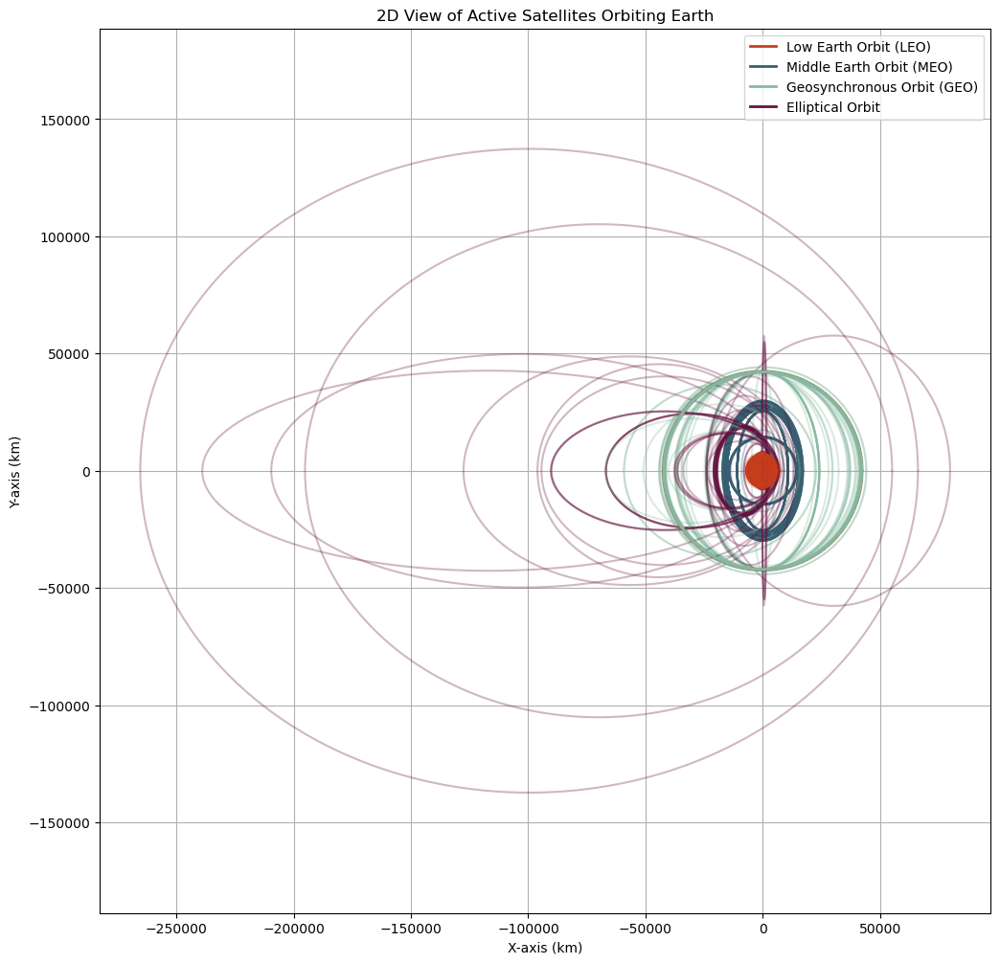

In [8]:
###
# Resources used:
# https://en.wikipedia.org/wiki/Orbital_elements
# https://en.wikipedia.org/wiki/Two-line_element_set
# Help with inclination orbit rotation - https://space.stackexchange.com/questions/44335/visualising-orbits-from-different-viewpoints-in-python
# 
###

def calc_ellipse(apogee, perigee, inclination_deg):

    earth_radius = 6370  # km
    inclination_rad = np.radians(inclination_deg)

    # Adjust altitudes into true apogee (distance to center of earth)
    # as data is assuming distance from surface, not center.
    apogee_adj = apogee + earth_radius
    perigee_adj = perigee + earth_radius

    # Calculating semi-major axis and eccentricity (we should check ecc. against data).
    a = (apogee_adj + perigee_adj) / 2
    e = (apogee - perigee) / (apogee_adj + perigee_adj)

    # Generate angles to find ellipse.
    angles = np.linspace(0, 2 * np.pi, 1000)

    # Calculating distance from Earth center for each angle.
    r = (a * (1 - (e ** 2))) / (1 + e * np.cos(angles))

    # Converting polar coords to Cartesian coords.
    x = r * np.cos(angles)
    y = r * np.sin(angles)

    # # Rotation matrix for inclination
    
    # # Z
    # rotation_matrix = np.array([
    #     [np.cos(inclination_rad), -np.sin(inclination_rad), 0],
    #     [np.sin(inclination_rad), np.cos(inclination_rad), 0],
    #     [0, 0, 1]
    # ])

    # # X
    # rotation_matrix = np.array([
    #     [1, 0, 0],
    #     [0, np.cos(inclination_rad), -np.sin(inclination_rad)],
    #     [0, np.sin(inclination_rad), np.cos(inclination_rad)]
        
    # ])

    # Y
    rotation_matrix = np.array([
        [np.cos(inclination_rad), 0, np.sin(inclination_rad)],
        [0, 1, 0],
        [-np.sin(inclination_rad), 0, np.cos(inclination_rad)]
        
    ])

    # Apply inclination to the orbit
    orbit = np.array([x, y, np.zeros_like(x)])
    rotated_orbit = np.matmul(rotation_matrix, orbit)

    x_rot, y_rot, z_rot = rotated_orbit # Don't need z for 2d.
    return (x_rot, y_rot)

plt.figure(figsize = (12, 12))

# Plotting the Earth at origin.
earth_circle = plt.Circle((0, 0), earth_radius, color = '#064273', alpha = 1, label = 'Earth')
plt.gca().add_patch(earth_circle)

# Create color mapping.
color_dict = {'Elliptical': '#64113F',
              'LEO': '#C73E1D',
              'MEO': '#385F71',
              'GEO': '#86BAA1'}

for i, j, k, orbit_class in orbits_inc:

    x, y = calc_ellipse(i, j, k)

    # Plotting the orbit.
    plt.plot(x, y, alpha = 0.3, color = color_dict[orbit_class])
    plt.title('2D View of Active Satellites Orbiting Earth')
    plt.xlabel('X-axis (km)')
    plt.ylabel('Y-axis (km)')
    plt.grid(True)
    plt.axis('equal')  # Set an equal aspect ratio

    cust_legend = [Line2D([0], [0], color = color_dict['LEO'], lw = 2),
                Line2D([0], [0], color = color_dict['MEO'], lw = 2),
                Line2D([0], [0], color = color_dict['GEO'], lw = 2),
                Line2D([0], [0], color = color_dict['Elliptical'], lw = 2)]
    plt.legend(cust_legend, ['Low Earth Orbit (LEO)', 'Middle Earth Orbit (MEO)', 'Geosynchronous Orbit (GEO)', 'Elliptical Orbit'])

plt.show()

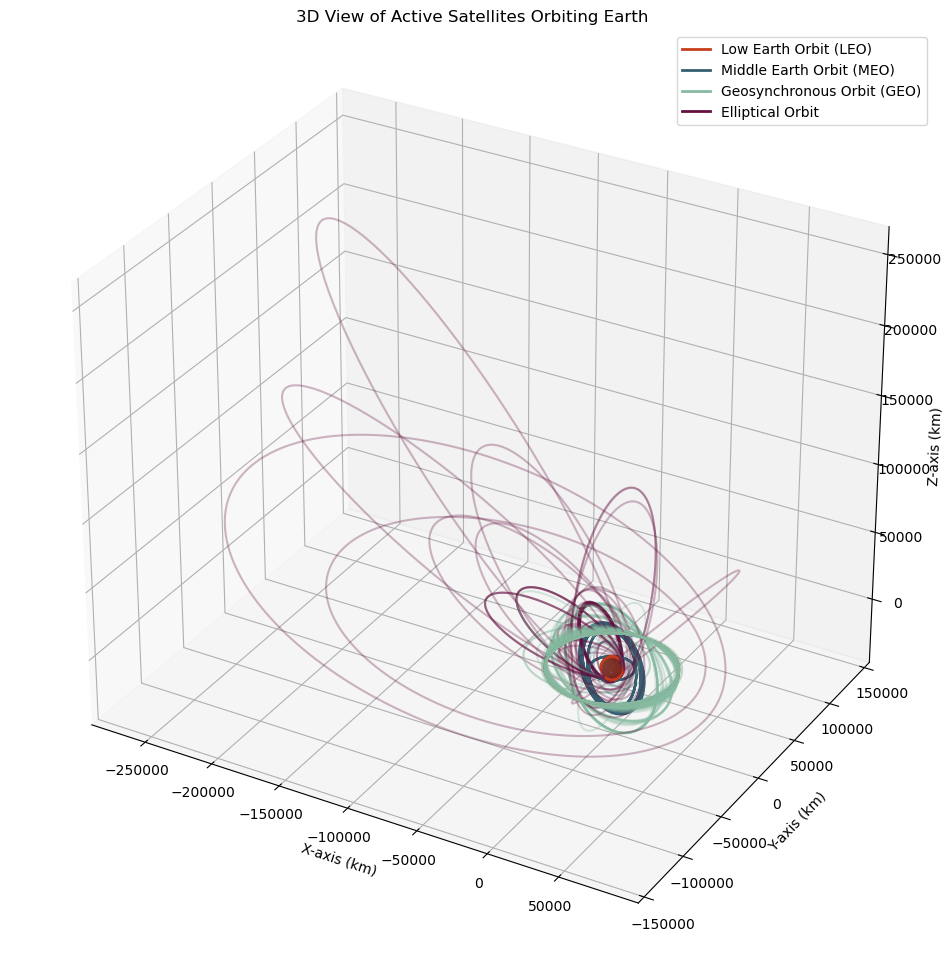

In [9]:


def calc_ellipse_3d(apogee, perigee, inclination_deg):

    # Constants
    earth_radius = 6370  # km

    # Given data
    apogee_adj = apogee + earth_radius
    perigee_adj = perigee + earth_radius
    inclination_rad = np.radians(inclination_deg)

    # Calculating semi-major axis and eccentricity
    a = (apogee_adj + perigee_adj) / 2
    e = (apogee - perigee) / (apogee_adj + perigee_adj)

    # Generating angles from 0 to 2*pi
    angles = np.linspace(0, 2 * np.pi, 1000)

    # Calculating distance from Earth center for each angle
    r = (a * (1 - (e ** 2))) / (1 + e * np.cos(angles))

    # Converting polar coordinates to Cartesian coordinates
    x = r * np.cos(angles)
    y = r * np.sin(angles)

    # Rotation matrix for inclination
    # # Z
    # rotation_matrix = np.array([
    #     [np.cos(inclination_rad), -np.sin(inclination_rad), 0],
    #     [np.sin(inclination_rad), np.cos(inclination_rad), 0],
    #     [0, 0, 1]
    # ])
    # # X
    # rotation_matrix = np.array([
    #     [1, 0, 0],
    #     [0, np.cos(inclination_rad), -np.sin(inclination_rad)],
    #     [0, np.sin(inclination_rad), np.cos(inclination_rad)]
        
    # ])
    # Y
    rotation_matrix = np.array([
        [np.cos(inclination_rad), 0, np.sin(inclination_rad)],
        [0, 1, 0],
        [-np.sin(inclination_rad), 0, np.cos(inclination_rad)]
        
    ])

    # Apply inclination to the orbit
    orbit = np.array([x, y, np.zeros_like(x)])
    rotated_orbit = np.matmul(rotation_matrix, orbit)

    x_rot, y_rot, z_rot = rotated_orbit
    return (x_rot, y_rot, z_rot)

# Creating a 3D plot
fig = plt.figure(figsize = (12, 12))
ax = fig.add_subplot(111, projection = '3d')

# # Plotting Earth
c = [0, 0, 0]
r = [earth_radius] # Radius of earth
u, v = np.mgrid[0:2 * np.pi:50j, 0:np.pi:50j]
x_e = r * np.cos(u) * np.sin(v)
y_e = r * np.sin(u) * np.sin(v)
z_e = r * np.cos(v)
ax.plot_surface(x_e - c[0], y_e - c[1], z_e - c[2], color= '#064273', alpha = 0.2)

# Create color mapping.
color_dict = {'Elliptical': '#64113F',
              'LEO': '#C73E1D',
              'MEO': '#385F71',
              'GEO': '#86BAA1'}

for i, j, k, orbit_class in orbits_inc:
    x, y, z = calc_ellipse_3d(i, j, k)

    # Plotting the orbit in a side-view perspective
    ax.plot(x, y, z, zdir='z', alpha = 0.3, color = color_dict[orbit_class])

# Set labels and title
ax.set_xlabel('X-axis (km)')
ax.set_ylabel('Y-axis (km)')
ax.set_zlabel('Z-axis (km)')
ax.set_box_aspect([1,1,1])
ax.set_aspect('equal')
ax.set_title('3D View of Active Satellites Orbiting Earth')

cust_legend = [Line2D([0], [0], color = color_dict['LEO'], lw = 2),
                Line2D([0], [0], color = color_dict['MEO'], lw = 2),
                Line2D([0], [0], color = color_dict['GEO'], lw = 2),
                Line2D([0], [0], color = color_dict['Elliptical'], lw = 2)]
ax.legend(cust_legend, ['Low Earth Orbit (LEO)', 'Middle Earth Orbit (MEO)', 'Geosynchronous Orbit (GEO)', 'Elliptical Orbit'])

plt.show()


##### Resources used in Orbit Plots:

- https://en.wikipedia.org/wiki/Orbital_elements
- https://en.wikipedia.org/wiki/Two-line_element_set
- Calculating orbit plane rotation using inclination- https://space.stackexchange.com/questions/44335/visualising-orbits-from-different-viewpoints-in-python


### Visualization Project Part 3: A Plan for Evaluation
---
In your previous post, you identified a series of tasks and goals for your visualization as well as some preliminary design ideas. We’ll jump ahead a few steps and start to think about how we might evaluate our design approach. Outline a preliminary evaluation that addresses your core goals with the visualization. Make sure your evaluation discusses: 

The target question you want to answer

The people you would recruit to answer that question

The kinds of measures you would use to answer your data (e.g., insight depth, use cases, accuracy) and what these measures would tell you about the core question

The approach you will use to answer that question (e.g., a journaling study, a formal experiment, etc.)

How you would instantiate those methods (i.e., what would your participants do?)

What criteria would you use to indicate that your visualization was successful

### Part 3 Answers:

##### Evaluation Plan:

- Task 1: *Data overview displaying key features organized by country.*
    - **Target Question** - What countries have the most active satellites? Of those top k countries what is the distribution in purpose of their active satellites? Are there any trends over time or across countries in their satellite distributions? 
    - **People to Recruit** - As this visualization is intended to turn surface-level knowledge about current active satellites into deeper insights, I would recruit people ranging from non-experts to space science enthusiasts so I could properly measure insight depth.
    - **Measures to be used to answer (e.g. insight depth, use cases, accuracy)** - Insight depth would would be the most interesting measure as this visualization is meant to allow the user to drill down and make comparisons across groups. Use cases also would be a useful measure.
    - **Specific Approach** - Depending on whether this evaluation would be formative or summative, a "thinkaloud" or journaling study respectively. Following along with the user's stream of consciousness on how they utilize the tool to "snowball" into deeper insights/questions would be important to understand what works or what needs to be adjusted or expanded.
    - **Method of Instantiation** - Users would be monitored and encouraged to think out loud while using the tool for a short period of time, then stopped and asked a few questions about insights or questions that are developing. The user then would be allowed to utilize the tool for a few minutes and asked to verbalize any insights or questions. These "thinkaloud" sessions would build a decision tree of sorts to further expand and improve the visualizations.
    - **Criteria to Indicate Success** - Just as the target questions set have different levels of insight required, the measure of success could be reached based on how deep of insights lead to which target questions along with the speed in which the deeper target questions are answered. Journaling results that indicate a wide range of use cases would also indicate success of the tool.

- Task 2: *Using dates of launch and life expectancy, display age statistics across features*
    - **Target Question** - Of the countries with the most active satellites, which countries have an aging satellite fleet? What owner sectors tend to have older satellites?
    - **People to Recruit** - Science journalists, space science enthusiasts, or political scientists interested in different country's space capabilities.
    - **Measures to be used to answer (e.g. insight depth, use cases, accuracy)** - Accuracy of insights using specific questions related to the target question. In other words, how accurately users can identify correlations between variables in the data distributions organized by categorical variables.
    - **Specific Approach** - Perform an experiment using a survey to capture how accurately users are able to identify correlations between countries, life expectancy of satellite remaining, and sector. Analyze results to determine how effective the tool is.
    - **Method of Instantiation** - Users would spend time with the tool, then be presented with a questionnaire asking the target questions which would then be analyzed and the tool would be given a score based on user answers.
    - **Criteria to Indicate Success** - Whether or not the target question has been answered. Specifically whether users accurately identify distribution of age of satellites across the presented data. The ease and speed in which these insights are gained.

- Task 3: *Calculate and visualize orbital paths of active satellites, labeling orbital class.*
    - **Target Question** - What type of orbit is the most common/congested (plane, distance)? Would you be able to identify different types of orbits and their defining characteristics?
    - **People to Recruit** - Science journalists, space science enthusiasts, or political scientists interested in different country's space capabilities.
    - **Measures to be used to answer (e.g. insight depth, use cases, accuracy)** - Accuracy of being able to identify orbit density.
    - **Specific Approach** - Perform an experiment using a survey to capture how accurately users are able to identify orbits and orbit density.
    - **Method of Instantiation** - UUsers would spend time with the tool, then be presented with a questionnaire asking the target questions which would then be analyzed and the tool would be given a score based on user answers.
    - **Criteria to Indicate Success** - Whether or not the target question has been answered. Specifically whether users are able to correctly identify defining orbital characteristics and each class of orbit's density.

### About the Final Project
---
Throughout the Modules, you have found a dataset, characterized the corresponding goals and tasks you want to conduct with that data, designed preliminary approaches, and outlined how you would evaluate those approaches. For your final project, you will put these ideas into practice by executing on the project plan outlined in your prior posts.

For this project, you will implement a visualization using your data from Module 1 and preliminary low-fidelity prototypes from Module 2 to address your stated goals. You may implement this visualization using either Altair or another platform of your choice. Once implemented, conduct your evaluation based on the plan outlined in your Module 3 discussion post, making sure to conduct your evaluation with at least three people. You may refine any of your prior plan to reflect your evolving understanding of the challenges you are addressing. Be sure to address how your plan has changed from these earlier posts as part of your discussion. 

Your final project post should include: 

A brief recap of your data, goals, and tasks, focusing on those that most directly influence your design

Screenshots of and/or a link to your visualization implementation (see below for additional guidance)

A summary of the key elements of your design and accompanying justification

A discussion of your final evaluation approach, including the procedure, people recruited, and results. Note that, due to the difficulty of recruiting experts, you can use colleagues, friends, classmates, or family to evaluate your designs if experts or others from your target population are unavailable. 

A synthesis of your findings, including what elements of your approach worked well and what elements you would refine in future iterations.

Guidance and platforms for deploying Altair visualizations online include: 

Altair: Interactive Plots on the Web

Add Animated Charts To Your Dashboards With Streamlit-Python

Creating Interactive Jupyter Notebooks and Deployment on Heroku Using Voila



### Survey Questionnaire

---

Proceed through these steps and answer the following questions.

1. Spend a maximum of 5-10 seconds with the visualization to get an initial impression and answer the following questions.
    - What is one piece of information you learned.
    - Using a little imagination, who would utilize/benefit most from this data representation?
2. Now revisit the visualization and verbalize anything you notice.
    - Starting from the most basic and then to more complex, what insights have you captured now that you've explored it further?
    - After spending some time with the visualization, are there any further questions/deeper insights that wish had been answered?
    - Are there any specific elements that were or weren't successful?
3. Did we answer the target questions? If not ask them and see if they can answer.

## User 1 (S)

### Task 1
1.  - **Initial impressions:** ESA = European Space Agency, USA has the most active satellites, China and UK are nearly equal.
    - **What role is this for?:** Governments, private companies looking to compete with SpaceX.
2. - **Final insights:** SpaceX has the vast majority of satellites, Majority of Russian satellite operators are from the government, not as many multinational as they would expect, Large increase of launches in 2021-22 in USA and China while UK cut their launches in half during the same period in time, The majority of US satellite functionality is used for communications.
    - **Questions or insights that arose but cannot be answered fully:** Deeper understanding of specifics in what the categories of functionality are, why there was a spike in launches between the last 2 years.
    - **Specific successes and failures of the visualization:**
        - **Successes:** Interactivity in selecting the bar, colors are nice and easy to read/distinguish between.
        - **Failures:** None!
3. **Did the user answer the target question unprompted?** Yes
    - **If not, where they able to after being prompted?** N/A

### Task 2
1.  - **Initial impressions:**
    - **What role is this for?:**
2. - **Final insights:**
    - **Questions or insights that arose but cannot be answered fully:**
    - **Specific successes and failures of the visualization:**
        - **Successes:**
        - **Failures:**
3. 
    - **Did the user answer the target question unprompted?**
        - **If not, where they able to after being prompted?**

### Task 3
1.  - **Initial impressions:**
    - **What role is this for?:**
2. - **Final insights:**
    - **Questions or insights that arose but cannot be answered fully:**
    - **Specific successes and failures of the visualization:**
        - **Successes:**
        - **Failures:**
3. 
    - **Did the user answer the target question unprompted?**
        - **If not, where they able to after being prompted?**

## User 2 (Z)

### Task 1
1.  - **Initial impressions:** Lots of slices of the data showing how many total satellites in different times, operators. | Noticed the log scale but needed to look harder to understand proportions | More countries than they would've expected. |
    - **What role is this for?:** Useful for anyone who is in charge of space regulation or government policy concerning space. | Politicians and lobbyists. | Private entities who need/want to launch satellites. | Research groups.
2. - **Final insights:** USA and SpaceX have the vast majority of satellites | Private satellites for communication are a large proportion. | Less military than anticipated and likely not reflecting reality. | Exponential growth in launches per year.
    - **Questions or insights that arose but cannot be answered fully:** Further aggregate by selections on satellite functionality, maybe highlighting the data on other graphs with selection.
    - **Specific successes and failures of the visualization:**
        - **Successes:** Time period is easy to understand. | Total number of satellites by each category is well represented and comparable. | Colors in category.
        - **Failures:** Data is "top-heavy" so comparing past the top k is difficult. | Density gray-scale highlights the top k well but not much else.
3. 
    - **Did the user answer the target question unprompted?** Yes
        - **If not, where they able to after being prompted?** N/A

### Task 2
1.  - **Initial impressions:** (Does not use boxplots) | Understands the purpose is to show life remaining of different types of satellites. | Lots of outliers for USA and UK in Commercial. 
    - **What role is this for?:** Data Analysts | Researchers | Policy and governance relating to space agencies. | Science journalism.
2. - **Final insights:** Military satellites have longevity and are generally older. | Probably indicates where their interests lie based on where the distributions are. |
    - **Questions or insights that arose but cannot be answered fully:** How many of each category make up these distributions.
    - **Specific successes and failures of the visualization:**
        - **Successes:** Good representation if you can read box plots. | Color coding helps a ton to compare.
        - **Failures:** Box plots are very user specific. | Number of each category. | Selection of each category to highlight would be useful.
3. 
    - **Did the user answer the target question unprompted?** Yes
        - **If not, where they able to after being prompted?** N/A

### Task 3
1.  - **Initial impressions:** Good indicator of which orbits we launch to, indicating most go to LEO. | Interested in the polar orbit, thinks it's likely showing maybe some science satellites. | The large elliptical orbits are interesting and wants to know more about those satellites. | Large amount of GEO orbits, and how much variety in their plane angles. |
    - **What role is this for?:** Space Agencies possibly between nations to help park satellites and track traffic. | Scientists planning new missions to find gaps in how we utilize our orbit.
2. - **Final insights:** GEO orbits have very specific orbits that form a few lanes that are more dense, with a few polar. | 
    - **Questions or insights that arose but cannot be answered fully:** Being able to pick out specific satellites and display more information (filtering). | Adding zoom to be able to distinguish more dense areas.
    - **Specific successes and failures of the visualization:**
        - **Successes:** Shows density pretty well with the overlapping opacity of the orbits. | Shows unique orbits really well.
        - **Failures:** Not good at showing more details as of yet. No slicing. | 
3. 
    - **Did the user answer the target question unprompted?** Yes
        - **If not, where they able to after being prompted?** N/A

## User 3 ()

### Task 1
1.  - **Initial impressions:** 
    - **What role is this for?:** 
2. - **Final insights:** 
    - **Questions or insights that arose but cannot be answered fully:** 
    - **Specific successes and failures of the visualization:** 
        - **Successes:** 
        - **Failures:** 
3. 
    - **Did the user answer the target question unprompted?** 
        - **If not, where they able to after being prompted?** 

### Task 2
1.  - **Initial impressions:** 
    - **What role is this for?:** 
2. - **Final insights:** 
    - **Questions or insights that arose but cannot be answered fully:** 
    - **Specific successes and failures of the visualization:** 
        - **Successes:** 
        - **Failures:** 
3. 
    - **Did the user answer the target question unprompted?** 
        - **If not, where they able to after being prompted?** 

### Task 3
1.  - **Initial impressions:** 
    - **What role is this for?:** 
2. - **Final insights:** 
    - **Questions or insights that arose but cannot be answered fully:** 
    - **Specific successes and failures of the visualization:** 
        - **Successes:** 
        - **Failures:** 
3. 
    - **Did the user answer the target question unprompted?** 
        - **If not, where they able to after being prompted?** 

### Task 1
1.  - **Initial impressions:**
    - **What role is this for?:**
2. - **Final insights:**
    - **Questions or insights that arose but cannot be answered fully:**
    - **Specific successes and failures of the visualization:**
        - **Successes:**
        - **Failures:**
3. 
    - **Did the user answer the target question unprompted?**
        - **If not, where they able to after being prompted?**

### Task 2
1.  - **Initial impressions:**
    - **What role is this for?:**
2. - **Final insights:**
    - **Questions or insights that arose but cannot be answered fully:**
    - **Specific successes and failures of the visualization:**
        - **Successes:**
        - **Failures:**
3. 
    - **Did the user answer the target question unprompted?**
        - **If not, where they able to after being prompted?**

### Task 3
1.  - **Initial impressions:**
    - **What role is this for?:**
2. - **Final insights:**
    - **Questions or insights that arose but cannot be answered fully:**
    - **Specific successes and failures of the visualization:**
        - **Successes:**
        - **Failures:**
3. 
    - **Did the user answer the target question unprompted?**
        - **If not, where they able to after being prompted?**